In [1]:
import pandas as pd
pd.set_option('display.max_columns', None) # Show all columns
pd.set_option('display.max_rows', None)      # Limit number of rows shown
pd.set_option('display.width', 1000)       # Width of the display in characters

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import scipy as sp
import scipy.stats as stats
import seaborn as sns
from sklearn import linear_model
import statsmodels.api as sm 
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.preprocessing import OneHotEncoder, StandardScaler, OrdinalEncoder, FunctionTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import cross_val_score, GridSearchCV
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, BaggingRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.impute import SimpleImputer

In [3]:
price = pd.read_csv('Ames_HousePrice.csv')
price.drop(columns=['Unnamed: 0'], inplace=True)
price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,909176150,856,126000,30,RL,NaN,7890,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,NaN,0.0,TA,TA,CBlock,TA,TA,No,Rec,238.0,Unf,0.0,618.0,856.0,GasA,TA,Y,SBrkr,856,0,0,1.0,0.0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2.0,399.0,TA,TA,Y,0,0,0,0,166,0,NaN,NaN,NaN,0,3,2010,WD,Normal
1,905476230,1049,139500,120,RL,42.0,4235,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149.0,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552.0,ALQ,393.0,104.0,1049.0,GasA,TA,Y,SBrkr,1049,0,0,1.0,0.0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,1984.0,Fin,1.0,266.0,TA,TA,Y,0,105,0,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal
2,911128020,1001,124900,30,C (all),60.0,6060,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,TA,BrkTil,TA,TA,No,ALQ,737.0,Unf,0.0,100.0,837.0,GasA,Ex,Y,SBrkr,1001,0,0,0.0,0.0,1,0,2,1,Gd,5,Typ,0,NaN,Detchd,1930.0,Unf,1.0,216.0,TA,Po,N,154,0,42,86,0,0,NaN,NaN,NaN,0,11,2007,WD,Normal
3,535377150,1039,114000,70,RL,80.0,8146,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0.0,Unf,0.0,405.0,405.0,GasA,Gd,Y,SBrkr,717,322,0,0.0,0.0,1,0,2,1,TA,6,Typ,0,NaN,Detchd,1940.0,Unf,1.0,281.0,TA,TA,N,0,0,168,0,111,0,NaN,NaN,NaN,0,5,2009,WD,Normal
4,534177230,1665,227000,60,RL,70.0,8400,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,643.0,Unf,0.0,167.0,810.0,GasA,Ex,Y,SBrkr,810,855,0,1.0,0.0,2,1,3,1,Gd,6,Typ,0,NaN,Attchd,2001.0,Fin,2.0,528.0,TA,TA,Y,0,45,0,0,0,0,NaN,NaN,NaN,0,11,2009,WD,Normal
5,908128060,1922,198500,85,RL,64.0,7301,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500.0,Gd,TA,Slab,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,Ex,Y,SBrkr,495,1427,0,0.0,0.0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2.0,672.0,TA,TA,Y,0,0,177,0,0,0,NaN,NaN,NaN,0,7,2009,ConLD,Normal
6,902135020,936,93000,20,RM,60.0,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Fa,TA,CBlock,Fa,TA,No,Unf,0.0,Unf,0.0,936.0,936.0,GasA,TA,N,SBrkr,936,0,0,0.0,0.0,1,0,2,1,TA,4,Min2,0,NaN,Detchd,1974.0,Unf,2.0,576.0,TA,TA,Y,0,32,112,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal
7,528228540,1246,187687,20,RL,53.0,3710,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20.0,Gd,TA,PConc,Gd,TA,Gd,Unf,0.0,Unf,0.0,1146.0,1146.0,GasA,Ex,Y,SBrkr,1246,0,0,0.0,0.0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2.0,428.0,TA,TA,Y,100,24,0,0,0,0,NaN,NaN,NaN,0,3,2008,New,Partial
8,923426010,889,137500,20,RL,74.0,12395,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Mitchel,Norm,Norm,1Fam,1Story,5,6,1984,1984,Gable,CompShg,HdBoard,Plywood,NaN,0.0,TA,TA,CBlock,TA,TA,No,ALQ,647.0,Unf,0.0,217.0,864.0,GasA,TA,Y,SBrkr,889,0,0,0.0,0.0,1,0,3,1,TA,6,Typ,0,NaN,Attchd,1984.0,Unf,2.0,484.0,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Normal
9,9081860

In [4]:
columns_to_sum = [
    'PoolArea', 'EnclosedPorch', 'ScreenPorch', 'OpenPorchSF', 'WoodDeckSF',
    '3SsnPorch', 'GarageArea', 'GrLivArea', 'TotalBsmtSF', 'MasVnrArea'
]

# Make sure all NaNs are treated as 0 before summing
price['TotalArea'] = price[columns_to_sum].fillna(0).sum(axis=1)

price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,TotalArea
0,909176150,856,126000,30,RL,NaN,7890,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,NaN,0.0,TA,TA,CBlock,TA,TA,No,Rec,238.0,Unf,0.0,618.0,856.0,GasA,TA,Y,SBrkr,856,0,0,1.0,0.0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2.0,399.0,TA,TA,Y,0,0,0,0,166,0,NaN,NaN,NaN,0,3,2010,WD,Normal,2277.0
1,905476230,1049,139500,120,RL,42.0,4235,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149.0,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552.0,ALQ,393.0,104.0,1049.0,GasA,TA,Y,SBrkr,1049,0,0,1.0,0.0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,1984.0,Fin,1.0,266.0,TA,TA,Y,0,105,0,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal,2618.0
2,911128020,1001,124900,30,C (all),60.0,6060,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,TA,BrkTil,TA,TA,No,ALQ,737.0,Unf,0.0,100.0,837.0,GasA,Ex,Y,SBrkr,1001,0,0,0.0,0.0,1,0,2,1,Gd,5,Typ,0,NaN,Detchd,1930.0,Unf,1.0,216.0,TA,Po,N,154,0,42,86,0,0,NaN,NaN,NaN,0,11,2007,WD,Normal,2336.0
3,535377150,1039,114000,70,RL,80.0,8146,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0.0,Unf,0.0,405.0,405.0,GasA,Gd,Y,SBrkr,717,322,0,0.0,0.0,1,0,2,1,TA,6,Typ,0,NaN,Detchd,1940.0,Unf,1.0,281.0,TA,TA,N,0,0,168,0,111,0,NaN,NaN,NaN,0,5,2009,WD,Normal,2004.0
4,534177230,1665,227000,60,RL,70.0,8400,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,643.0,Unf,0.0,167.0,810.0,GasA,Ex,Y,SBrkr,810,855,0,1.0,0.0,2,1,3,1,Gd,6,Typ,0,NaN,Attchd,2001.0,Fin,2.0,528.0,TA,TA,Y,0,45,0,0,0,0,NaN,NaN,NaN,0,11,2009,WD,Normal,3048.0
5,908128060,1922,198500,85,RL,64.0,7301,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500.0,Gd,TA,Slab,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,Ex,Y,SBrkr,495,1427,0,0.0,0.0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2.0,672.0,TA,TA,Y,0,0,177,0,0,0,NaN,NaN,NaN,0,7,2009,ConLD,Normal,3271.0
6,902135020,936,93000,20,RM,60.0,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Fa,TA,CBlock,Fa,TA,No,Unf,0.0,Unf,0.0,936.0,936.0,GasA,TA,N,SBrkr,936,0,0,0.0,0.0,1,0,2,1,TA,4,Min2,0,NaN,Detchd,1974.0,Unf,2.0,576.0,TA,TA,Y,0,32,112,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal,2592.0
7,528228540,1246,187687,20,RL,53.0,3710,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20.0,Gd,TA,PConc,Gd,TA,Gd,Unf,0.0,Unf,0.0,1146.0,1146.0,GasA,Ex,Y,SBrkr,1246,0,0,0.0,0.0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2.0,428.0,TA,TA,Y,100,24,0,0,0,0,NaN,NaN,NaN,0,3,2008,New,Partial,2964.0
8,923426010,889,137500,20,RL,74.0,12395,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Mitchel,Norm,Norm,1Fam,1Story,5,6,1984,1984,Gable,CompShg,HdBoard,Plywood,NaN,0.0,TA,TA,CBlock,TA,TA,No,ALQ,647.0,Unf,0.0,217.0,864.0,GasA,TA,Y,SBrkr,889,0,0,0.0,0.0,1,0,3,1,TA,6,Typ,0,NaN,Attchd,1984.0,Unf,2.0,

In [5]:
columns_to_sum1 = [
    'BsmtFullBath', 'FullBath'
]

# Make sure all NaNs are treated as 0 before summing
price['TotalFullBath'] = price[columns_to_sum1].fillna(0).sum(axis=1)

columns_to_sum2 = [
    'BsmtHalfBath', 'HalfBath'
]

# Make sure all NaNs are treated as 0 before summing
price['TotalHalfBath'] = price[columns_to_sum2].fillna(0).sum(axis=1)

In [6]:
price['Alley'] = price['Alley'].fillna('No Alley Access')
price['MasVnrType'] = price['MasVnrType'].fillna('None')
price['BsmtQual'] = price['BsmtQual'].fillna('No Basement')
price['BsmtCond'] = price['BsmtCond'].fillna('No Basement')
price['BsmtExposure'] = price['BsmtExposure'].fillna('No Basement')
price['BsmtFinType1'] = price['BsmtFinType1'].fillna('No Basement')
price['BsmtFinType2'] = price['BsmtFinType2'].fillna('No Basement')
price['FireplaceQu'] = price['FireplaceQu'].fillna('No Fireplace')
price['GarageType'] = price['GarageType'].fillna('No Garage')
price['GarageYrBlt'] = price['GarageYrBlt'].fillna('No Garage')
price['GarageFinish'] = price['GarageFinish'].fillna('No Garage')
price['GarageQual'] = price['GarageQual'].fillna('No Garage')
price['GarageCond'] = price['GarageCond'].fillna('No Garage')
price['PoolQC'] = price['PoolQC'].fillna('No Pool')
price['Fence'] = price['Fence'].fillna('No Fence')
price['MiscFeature'] = price['MiscFeature'].fillna('None')

In [7]:
price.loc[price['MasVnrType'] == 'None', 'MasVnrArea'] = 0
price.loc[price['BsmtFinType1'] == 'No Basement', 'BsmtFinSF1'] = 0
price.loc[price['BsmtFinType2'] == 'No Basement', 'BsmtFinSF2'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'BsmtUnfSF'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'TotalBsmtSF'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'BsmtFullBath'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'BsmtHalfBath'] = 0
price.loc[price['GarageFinish'] == 'No Garage', 'GarageCars'] = 0
price.loc[price['GarageFinish'] == 'No Garage', 'GarageArea'] = 0

In [8]:
price['MasVnrArea'] = price['MasVnrArea'].fillna(0).astype('int64')
price['BsmtFinSF1'] = price['BsmtFinSF1'].fillna(0).astype('int64')
price['BsmtFinSF2'] = price['BsmtFinSF2'].fillna(0).astype('int64')
price['BsmtUnfSF'] = price['BsmtUnfSF'].fillna(0).astype('int64')
price['TotalBsmtSF'] = price['TotalBsmtSF'].fillna(0).astype('int64')
price['BsmtFullBath'] = price['BsmtFullBath'].fillna(0).astype('int64')
price['GarageCars'] = price['GarageCars'].fillna(0).astype('int64')
price['BsmtHalfBath'] = price['BsmtHalfBath'].fillna(0).astype('int64')
price['GarageArea'] = price['GarageArea'].fillna(0).astype('int64')

In [9]:
# Identify numeric and categorical features, excluding 'PID' and 'SalePrice'
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice']).columns
categorical_features = price.select_dtypes(include=['object']).columns

# Fill missing values for categorical and numeric columns
for col in categorical_features:
    mode_val = price[col].mode()[0]
    price[col] = price[col].fillna(mode_val).astype(str)  # ✅ Cast to string

for col in numeric_features:
    price[col] = price[col].fillna(price[col].mean())

In [10]:
price.isnull().sum()

PID              0
GrLivArea        0
SalePrice        0
MSSubClass       0
MSZoning         0
LotFrontage      0
LotArea          0
Street           0
Alley            0
LotShape         0
LandContour      0
Utilities        0
LotConfig        0
LandSlope        0
Neighborhood     0
Condition1       0
Condition2       0
BldgType         0
HouseStyle       0
OverallQual      0
OverallCond      0
YearBuilt        0
YearRemodAdd     0
RoofStyle        0
RoofMatl         0
Exterior1st      0
Exterior2nd      0
MasVnrType       0
MasVnrArea       0
ExterQual        0
ExterCond        0
Foundation       0
BsmtQual         0
BsmtCond         0
BsmtExposure     0
BsmtFinType1     0
BsmtFinSF1       0
BsmtFinType2     0
BsmtFinSF2       0
BsmtUnfSF        0
TotalBsmtSF      0
Heating          0
HeatingQC        0
CentralAir       0
Electrical       0
1stFlrSF         0
2ndFlrSF         0
LowQualFinSF     0
BsmtFullBath     0
BsmtHalfBath     0
FullBath         0
HalfBath         0
BedroomAbvGr

In [11]:
# Define what counts as a finished basement
finished_basement_types = ['GLQ', 'ALQ', 'BLQ', 'Rec', 'LwQ']

# Create new total room feature including finished basement types
price['TotalFinishedRooms'] = (
    price['TotRmsAbvGrd'] +
    price['BsmtFinType1'].apply(lambda x: 1 if x in finished_basement_types else 0) +
    price['BsmtFinType2'].apply(lambda x: 1 if x in finished_basement_types else 0)
)

price['TotalBathrooms'] = (
    price['FullBath'].fillna(0) +
    price['HalfBath'].fillna(0) * 0.5 +
    price['BsmtFullBath'].fillna(0) +
    price['BsmtHalfBath'].fillna(0) * 0.5
)

price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,TotalArea,TotalFullBath,TotalHalfBath,TotalFinishedRooms,TotalBathrooms
0,909176150,856,126000,30,RL,68.516053,7890,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,None,0,TA,TA,CBlock,TA,TA,No,Rec,238,Unf,0,618,856,GasA,TA,Y,SBrkr,856,0,0,1,0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2,399,TA,TA,Y,0,0,0,0,166,0,No Pool,No Fence,None,0,3,2010,WD,Normal,2277.0,2.0,0.0,5,2.0
1,905476230,1049,139500,120,RL,42.000000,4235,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552,ALQ,393,104,1049,GasA,TA,Y,SBrkr,1049,0,0,1,0,2,0,2,1,Gd,5,Typ,0,No Fireplace,Attchd,1984.0,Fin,1,266,TA,TA,Y,0,105,0,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2618.0,3.0,0.0,7,3.0
2,911128020,1001,124900,30,C (all),60.000000,6060,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,None,0,Gd,TA,BrkTil,TA,TA,No,ALQ,737,Unf,0,100,837,GasA,Ex,Y,SBrkr,1001,0,0,0,0,1,0,2,1,Gd,5,Typ,0,No Fireplace,Detchd,1930.0,Unf,1,216,TA,Po,N,154,0,42,86,0,0,No Pool,No Fence,None,0,11,2007,WD,Normal,2336.0,1.0,0.0,6,1.0
3,535377150,1039,114000,70,RL,80.000000,8146,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,None,0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0,Unf,0,405,405,GasA,Gd,Y,SBrkr,717,322,0,0,0,1,0,2,1,TA,6,Typ,0,No Fireplace,Detchd,1940.0,Unf,1,281,TA,TA,N,0,0,168,0,111,0,No Pool,No Fence,None,0,5,2009,WD,Normal,2004.0,1.0,0.0,6,1.0
4,534177230,1665,227000,60,RL,70.000000,8400,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,None,0,Gd,TA,PConc,Gd,TA,No,GLQ,643,Unf,0,167,810,GasA,Ex,Y,SBrkr,810,855,0,1,0,2,1,3,1,Gd,6,Typ,0,No Fireplace,Attchd,2001.0,Fin,2,528,TA,TA,Y,0,45,0,0,0,0,No Pool,No Fence,None,0,11,2009,WD,Normal,3048.0,3.0,1.0,7,3.5
5,908128060,1922,198500,85,RL,64.000000,7301,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500,Gd,TA,Slab,No Basement,No Basement,No Basement,No Basement,0,No Basement,0,0,0,GasA,Ex,Y,SBrkr,495,1427,0,0,0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2,672,TA,TA,Y,0,0,177,0,0,0,No Pool,No Fence,None,0,7,2009,ConLD,Normal,3271.0,3.0,0.0,7,3.0
6,902135020,936,93000,20,RM,60.000000,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,None,0,Fa,TA,CBlock,Fa,TA,No,Unf,0,Unf,0,936,936,GasA,TA,N,SBrkr,936,0,0,0,0,1,0,2,1,TA,4,Min2,0,No Fireplace,Detchd,1974.0,Unf,2,576,TA,TA,Y,0,32,112,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2592.0,1.0,0.0,4,1.0
7,528228540,1246,187687,20,RL,53.000000,3710,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20,Gd,TA,PConc,Gd,TA,Gd,Unf,0,Unf,0,1146,1146,GasA,Ex,Y,SBrkr,1246,0,0,0,0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2,428,TA,TA,Y,100,24,0,0,0,0,No Pool,No Fence,None,0,3

In [12]:
# 2. Create the model
ols = linear_model.LinearRegression()

# Select only numerical columns
numerical_cols = price.select_dtypes(include=[np.number]).columns

# Target variable
y = price['SalePrice']

# Empty dictionary to store R² values
r2_scores = {}

for col in numerical_cols:
    if col != 'SalePrice':  # skip the target itself
        if price[col].isnull().sum() == 0:  # check if no missing values
            X = price[[col]]  # must be 2D
            ols.fit(X, y)
            r2 = ols.score(X, y)  # get R²
            r2_scores[col] = r2
        else:
            pass  # skip columns with NaN

# 6. Sort results by R² descending
sorted_r2 = dict(sorted(r2_scores.items(), key=lambda item: item[1], reverse=True))

# 7. Display nicely
for feature, r2 in sorted_r2.items():
    print(f"{feature}: R² = {r2:.4f}")

TotalArea: R² = 0.7311
OverallQual: R² = 0.6249
GrLivArea: R² = 0.5184
TotalBsmtSF: R² = 0.4257
1stFlrSF: R² = 0.4130
TotalBathrooms: R² = 0.4096
GarageCars: R² = 0.4070
GarageArea: R² = 0.4023
TotalFullBath: R² = 0.3541
YearBuilt: R² = 0.2963
FullBath: R² = 0.2862
TotalFinishedRooms: R² = 0.2692
YearRemodAdd: R² = 0.2645
MasVnrArea: R² = 0.2478
TotRmsAbvGrd: R² = 0.2403
Fireplaces: R² = 0.2383
BsmtFinSF1: R² = 0.2126
LotFrontage: R² = 0.1145
WoodDeckSF: R² = 0.1110
OpenPorchSF: R² = 0.0940
BsmtFullBath: R² = 0.0845
HalfBath: R² = 0.0817
LotArea: R² = 0.0753
2ndFlrSF: R² = 0.0692
TotalHalfBath: R² = 0.0619
PID: R² = 0.0512
BsmtUnfSF: R² = 0.0282
BedroomAbvGr: R² = 0.0230
EnclosedPorch: R² = 0.0152
ScreenPorch: R² = 0.0148
KitchenAbvGr: R² = 0.0130
OverallCond: R² = 0.0102
MSSubClass: R² = 0.0072
BsmtHalfBath: R² = 0.0011
3SsnPorch: R² = 0.0010
PoolArea: R² = 0.0010
LowQualFinSF: R² = 0.0010
BsmtFinSF2: R² = 0.0004
MiscVal: R² = 0.0004
MoSold: R² = 0.0002
YrSold: R² = 0.0000


In [13]:
# Automatically detect categorical columns
categorical_cols = price.select_dtypes(include='object').columns.tolist()
target = 'SalePrice'

# Fill missing values
price[categorical_cols] = price[categorical_cols].fillna('Missing')
price[target] = price[target].fillna(0)

# Collect (feature, r²) pairs
r2_results = []

for col in categorical_cols:
    X = price[[col]].fillna('Missing').astype(str)
    y = price[target]

    preprocessor = ColumnTransformer(
        transformers=[
            ('cat', OneHotEncoder(drop='first'), [col])
        ]
    )

    pipeline = Pipeline([
        ('prep', preprocessor),
        ('reg', LinearRegression())
    ])

    pipeline.fit(X, y)
    y_pred = pipeline.predict(X)
    r2 = r2_score(y, y_pred)

    r2_results.append((col, r2))

# Sort results descending by R²
r2_results_sorted = sorted(r2_results, key=lambda item: item[1], reverse=True)

# Print
for feature, r2 in r2_results_sorted:
    print(f"{feature}: R² = {r2:.4f}")

Neighborhood: R² = 0.5598
ExterQual: R² = 0.4853
BsmtQual: R² = 0.4814
KitchenQual: R² = 0.4579
GarageYrBlt: R² = 0.3896
FireplaceQu: R² = 0.3010
GarageFinish: R² = 0.2906
Foundation: R² = 0.2671
GarageType: R² = 0.2344
BsmtFinType1: R² = 0.2291
HeatingQC: R² = 0.2024
BsmtExposure: R² = 0.1812
MasVnrType: R² = 0.1711
Exterior1st: R² = 0.1551
Exterior2nd: R² = 0.1538
MSZoning: R² = 0.1160
LotShape: R² = 0.0942
GarageQual: R² = 0.0869
SaleType: R² = 0.0813
GarageCond: R² = 0.0782
PavedDrive: R² = 0.0725
SaleCondition: R² = 0.0722
HouseStyle: R² = 0.0710
CentralAir: R² = 0.0664
RoofStyle: R² = 0.0587
Electrical: R² = 0.0566
BsmtCond: R² = 0.0499
Condition1: R² = 0.0453
Fence: R² = 0.0362
BldgType: R² = 0.0330
LandContour: R² = 0.0323
BsmtFinType2: R² = 0.0297
Condition2: R² = 0.0247
ExterCond: R² = 0.0220
LotConfig: R² = 0.0211
RoofMatl: R² = 0.0208
Alley: R² = 0.0202
Functional: R² = 0.0137
PoolQC: R² = 0.0118
Heating: R² = 0.0079
LandSlope: R² = 0.0063
MiscFeature: R² = 0.0042
Street: R

/var/folders/cl/t0tgh5md7pj6srx85p45398h0000gq/T/ipykernel_37359/4209906869.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='R2 Score', y='Feature', data=top5_df, palette='viridis')


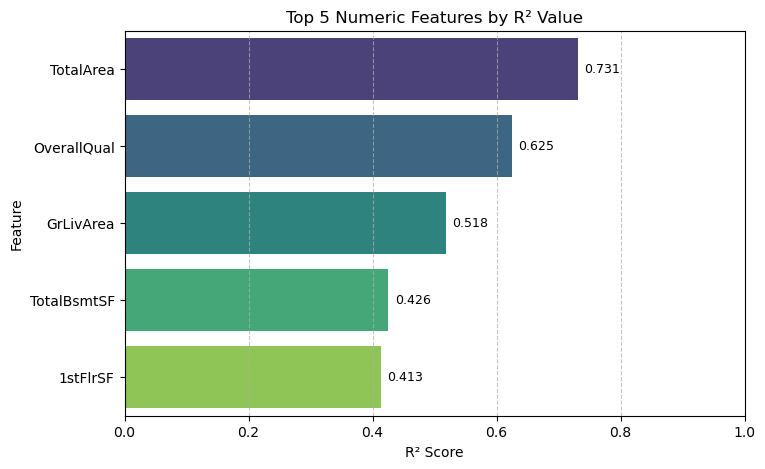

In [14]:
# Extract top 5 features
top5_features_n = list(sorted_r2.keys())[:5]
top5_r2_values_n = [sorted_r2[feature] for feature in top5_features_n]

# Create DataFrame for plotting
top5_df = pd.DataFrame({
    'Feature': top5_features_n,
    'R2 Score': top5_r2_values_n
})

# Plot
plt.figure(figsize=(8, 5))
sns.barplot(x='R2 Score', y='Feature', data=top5_df, palette='viridis')
plt.title('Top 5 Numeric Features by R² Value')
plt.xlabel('R² Score')
plt.ylabel('Feature')
plt.xlim(0, 1)  # R² ranges from 0 to 1
plt.grid(axis='x', linestyle='--', alpha=0.7)

# Annotate R² scores on each bar
for index, value in enumerate(top5_r2_values_n):
    plt.text(value + 0.01, index, f'{value:.3f}', va='center', fontsize=9)

plt.show()

/var/folders/cl/t0tgh5md7pj6srx85p45398h0000gq/T/ipykernel_37359/2716737044.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='R2 Score', y='Feature', data=top5_df, palette='viridis')


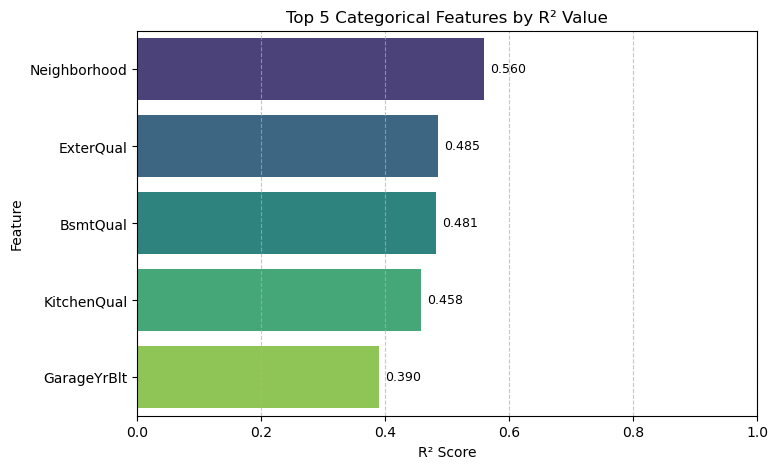

In [15]:
# Extract top 5 features
top5_features_c = [feature for feature, r2 in r2_results_sorted[:5]]
top5_r2_values_c = [r2 for feature, r2 in r2_results_sorted[:5]]

# Create DataFrame for plotting
top5_df = pd.DataFrame({
    'Feature': top5_features_c,
    'R2 Score': top5_r2_values_c
})

# Plot
plt.figure(figsize=(8, 5))
sns.barplot(x='R2 Score', y='Feature', data=top5_df, palette='viridis')
plt.title('Top 5 Categorical Features by R² Value')
plt.xlabel('R² Score')
plt.ylabel('Feature')
plt.xlim(0, 1)  # R² ranges from 0 to 1
plt.grid(axis='x', linestyle='--', alpha=0.7)

# Annotate R² scores on each bar
for index, value in enumerate(top5_r2_values_c):
    plt.text(value + 0.01, index, f'{value:.3f}', va='center', fontsize=9)

plt.show()

/var/folders/cl/t0tgh5md7pj6srx85p45398h0000gq/T/ipykernel_37359/935332262.py:23: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='R2 Score', y='Feature', data=top10_df, palette='viridis')


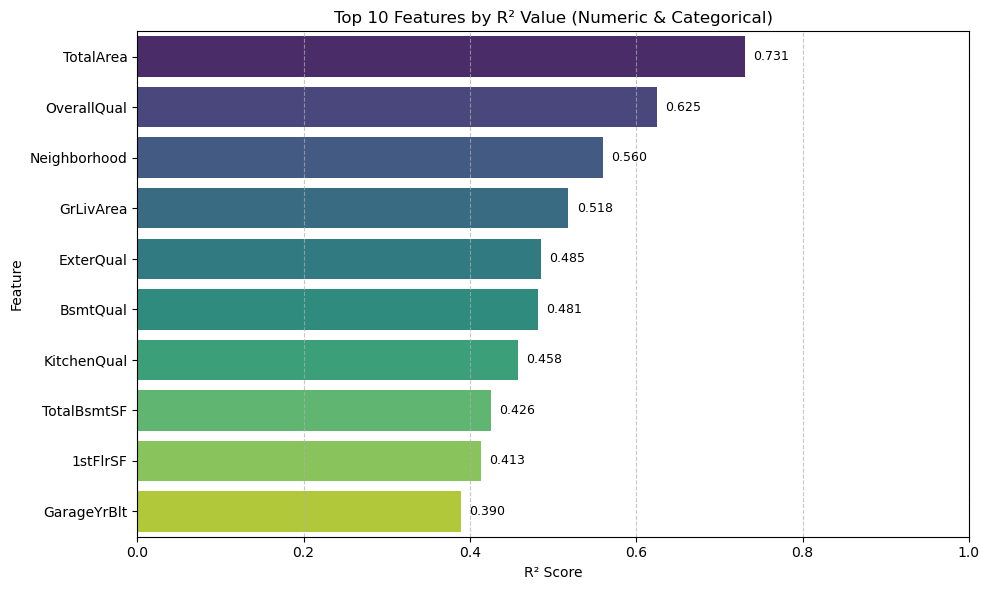

In [16]:
# ---- Top 5 Numeric Features ----
top5_features_n = list(sorted_r2.keys())[:5]
top5_r2_values_n = [sorted_r2[feature] for feature in top5_features_n]
top5_type_n = ['Numeric'] * 5  # Label type

# ---- Top 5 Categorical Features ----
top5_features_c = [feature for feature, r2 in r2_results_sorted[:5]]
top5_r2_values_c = [r2 for feature, r2 in r2_results_sorted[:5]]
top5_type_c = ['Categorical'] * 5  # Label type

# ---- Combine into a single DataFrame ----
top10_df = pd.DataFrame({
    'Feature': top5_features_n + top5_features_c,
    'R2 Score': top5_r2_values_n + top5_r2_values_c,
    'Feature Type': top5_type_n + top5_type_c
})

# ---- Sort by R² Score (descending) ----
top10_df = top10_df.sort_values(by='R2 Score', ascending=False).reset_index(drop=True)

# ---- Plot ----
plt.figure(figsize=(10, 6))
sns.barplot(x='R2 Score', y='Feature', data=top10_df, palette='viridis')

plt.title('Top 10 Features by R² Value (Numeric & Categorical)')
plt.xlabel('R² Score')
plt.ylabel('Feature')
plt.xlim(0, 1)  # R² ranges from 0 to 1
plt.grid(axis='x', linestyle='--', alpha=0.7)

# Annotate R² scores on bars
for index, value in enumerate(top10_df['R2 Score']):
    plt.text(value + 0.01, index, f'{value:.3f}', va='center', fontsize=9)

plt.tight_layout()
plt.show()


In [17]:
# Define what counts as a finished basement
finished_basement_types = ['GLQ', 'ALQ', 'BLQ', 'Rec', 'LwQ']

# Create new total room feature including finished basement types
price['TotalFinishedRooms'] = (
    price['TotRmsAbvGrd'] +
    price['BsmtFinType1'].apply(lambda x: 1 if x in finished_basement_types else 0) +
    price['BsmtFinType2'].apply(lambda x: 1 if x in finished_basement_types else 0)
)

price['TotalBathrooms'] = (
    price['FullBath'].fillna(0) +
    price['HalfBath'].fillna(0) * 0.5 +
    price['BsmtFullBath'].fillna(0) +
    price['BsmtHalfBath'].fillna(0) * 0.5
)

In [18]:
mode_val = price['Electrical'].mode(dropna=True)[0] 
price['Electrical'] = price['Electrical'].fillna(mode_val)

In [19]:
# Identify numeric and categorical features, excluding 'PID' and 'SalePrice'
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice']).columns
categorical_features = price.select_dtypes(include=['object']).columns

# Fill missing values for categorical and numeric columns
for col in categorical_features:
    mode_val = price[col].mode()[0]
    price[col] = price[col].fillna(mode_val).astype(str)  # ✅ Cast to string

for col in numeric_features:
    price[col] = price[col].fillna(price[col].mean())

price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,TotalArea,TotalFullBath,TotalHalfBath,TotalFinishedRooms,TotalBathrooms
0,909176150,856,126000,30,RL,68.516053,7890,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,None,0,TA,TA,CBlock,TA,TA,No,Rec,238,Unf,0,618,856,GasA,TA,Y,SBrkr,856,0,0,1,0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2,399,TA,TA,Y,0,0,0,0,166,0,No Pool,No Fence,None,0,3,2010,WD,Normal,2277.0,2.0,0.0,5,2.0
1,905476230,1049,139500,120,RL,42.000000,4235,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552,ALQ,393,104,1049,GasA,TA,Y,SBrkr,1049,0,0,1,0,2,0,2,1,Gd,5,Typ,0,No Fireplace,Attchd,1984.0,Fin,1,266,TA,TA,Y,0,105,0,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2618.0,3.0,0.0,7,3.0
2,911128020,1001,124900,30,C (all),60.000000,6060,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,None,0,Gd,TA,BrkTil,TA,TA,No,ALQ,737,Unf,0,100,837,GasA,Ex,Y,SBrkr,1001,0,0,0,0,1,0,2,1,Gd,5,Typ,0,No Fireplace,Detchd,1930.0,Unf,1,216,TA,Po,N,154,0,42,86,0,0,No Pool,No Fence,None,0,11,2007,WD,Normal,2336.0,1.0,0.0,6,1.0
3,535377150,1039,114000,70,RL,80.000000,8146,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,None,0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0,Unf,0,405,405,GasA,Gd,Y,SBrkr,717,322,0,0,0,1,0,2,1,TA,6,Typ,0,No Fireplace,Detchd,1940.0,Unf,1,281,TA,TA,N,0,0,168,0,111,0,No Pool,No Fence,None,0,5,2009,WD,Normal,2004.0,1.0,0.0,6,1.0
4,534177230,1665,227000,60,RL,70.000000,8400,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,None,0,Gd,TA,PConc,Gd,TA,No,GLQ,643,Unf,0,167,810,GasA,Ex,Y,SBrkr,810,855,0,1,0,2,1,3,1,Gd,6,Typ,0,No Fireplace,Attchd,2001.0,Fin,2,528,TA,TA,Y,0,45,0,0,0,0,No Pool,No Fence,None,0,11,2009,WD,Normal,3048.0,3.0,1.0,7,3.5
5,908128060,1922,198500,85,RL,64.000000,7301,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500,Gd,TA,Slab,No Basement,No Basement,No Basement,No Basement,0,No Basement,0,0,0,GasA,Ex,Y,SBrkr,495,1427,0,0,0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2,672,TA,TA,Y,0,0,177,0,0,0,No Pool,No Fence,None,0,7,2009,ConLD,Normal,3271.0,3.0,0.0,7,3.0
6,902135020,936,93000,20,RM,60.000000,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,None,0,Fa,TA,CBlock,Fa,TA,No,Unf,0,Unf,0,936,936,GasA,TA,N,SBrkr,936,0,0,0,0,1,0,2,1,TA,4,Min2,0,No Fireplace,Detchd,1974.0,Unf,2,576,TA,TA,Y,0,32,112,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2592.0,1.0,0.0,4,1.0
7,528228540,1246,187687,20,RL,53.000000,3710,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20,Gd,TA,PConc,Gd,TA,Gd,Unf,0,Unf,0,1146,1146,GasA,Ex,Y,SBrkr,1246,0,0,0,0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2,428,TA,TA,Y,100,24,0,0,0,0,No Pool,No Fence,None,0,3

In [20]:
# Exclude 'PID' and 'SalePrice' from features and specifically handle the 'Electrical' column
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice']).columns
categorical_features = price.select_dtypes(include=['object']).columns.difference(['Electrical'])
electrical_feature = ['Electrical']
 
# Manually specify the categories for ordinal encoding according to the data dictionary
ordinal_order = {
    'Electrical': ['Mix', 'FuseP', 'FuseF', 'FuseA', 'SBrkr'],  # Electrical system
    'LotShape': ['IR3', 'IR2', 'IR1', 'Reg'],  # General shape of property
    'Utilities': ['ELO', 'NoSeWa', 'NoSewr', 'AllPub'],  # Type of utilities available
    'LandSlope': ['Sev', 'Mod', 'Gtl'],  # Slope of property
    'ExterQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Evaluates the quality of the material on the exterior
    'ExterCond': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Evaluates the present condition of the material on the exterior
    'BsmtQual': ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Height of the basement
    'BsmtCond': ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # General condition of the basement
    'BsmtExposure': ['No Basement', 'No', 'Mn', 'Av', 'Gd'],  # Walkout or garden level basement walls
    'BsmtFinType1': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],  # Quality of basement finished area
    'BsmtFinType2': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],  # Quality of second basement finished area
    'HeatingQC': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Heating quality and condition
    'KitchenQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Kitchen quality
    'Functional': ['Sal', 'Sev', 'Maj2', 'Maj1', 'Mod', 'Min2', 'Min1', 'Typ'],  # Home functionality
    'FireplaceQu': ['No Fireplace', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Fireplace quality
    'GarageFinish': ['No Garage', 'Unf', 'RFn', 'Fin'],  # Interior finish of the garage
    'GarageQual': ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Garage quality
    'GarageCond': ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Garage condition
    'PavedDrive': ['N', 'P', 'Y'],  # Paved driveway
    'PoolQC': ['No Pool', 'Fa', 'TA', 'Gd', 'Ex'],  # Pool quality
    'Fence': ['No Fence', 'MnWw', 'GdWo', 'MnPrv', 'GdPrv']  # Fence quality
}
 
# Extract list of ALL ordinal features from dictionary
ordinal_features = list(ordinal_order.keys())
 
# List of ordinal features except Electrical
ordinal_except_electrical = [feature for feature in ordinal_features if feature != 'Electrical']

In [21]:
mode_val = price['Electrical'].mode(dropna=True)[0] 
price['Electrical'] = price['Electrical'].fillna(mode_val)

# Identify numeric and categorical features, excluding 'PID' and 'SalePrice'
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice']).columns
categorical_features = price.select_dtypes(include=['object']).columns

# Fill missing values for categorical and numeric columns
for col in categorical_features:
    mode_val = price[col].mode()[0]
    price[col] = price[col].fillna(mode_val).astype(str)  # ✅ Cast to string

for col in numeric_features:
    price[col] = price[col].fillna(price[col].mean())

In [22]:
# Example: assuming you have these CV R² scores stored for each model:
# (you might have different variable names; adjust accordingly)

# With TotalArea:
ridge_scores_with_totalarea = [0.86582737, 0.91917372, 0.92835274, 0.92378468, 0.9251988]
lasso_scores_with_totalarea = [0.8713594, 0.9180901, 0.90812129, 0.9235396, 0.91445024]
mlr_scores_all_with_totalarea = [0.86326765, 0.91553264, 0.92600101, 0.91629201, 0.92130404]
mlr_scores_some_with_totalarea = [0.86050271, 0.8994339, 0.90742726, 0.89085743, 0.89431368]
tree_scores_with_totalarea = [0.7646, 0.7556, 0.7998, 0.6996, 0.8041]
bagging_scores_with_totalarea = [0.8657, 0.8894, 0.9251, 0.9096, 0.9113]
forest_scores_with_totalarea = [0.8628, 0.8893, 0.9242, 0.9094, 0.9108]
boost_scores_with_totalarea = [0.8609, 0.9142, 0.935,  0.9302, 0.9383]



# Without TotalArea:
ridge_scores_no_totalarea = [0.86596413, 0.91922374, 0.92833033, 0.92380009, 0.92522281]
lasso_scores_no_totalarea = [0.87134555, 0.91809058, 0.90810431, 0.92357651, 0.91441369]
mlr_scores_all_no_totalarea = [0.86478822, 0.91341227, 0.92369543, 0.91754021, 0.9189876]
mlr_scores_some_no_totalarea = [0.86794553, 0.90878715, 0.9156098, 0.90588645, 0.90422014]
tree_scores_no_totalarea = [0.7564, 0.7976, 0.7821, 0.7525, 0.7553]
bagging_scores_no_totalarea = [0.8459, 0.891,  0.9047, 0.913, 0.9131]
forest_scores_no_totalarea = [0.8471, 0.8907, 0.9015, 0.9128, 0.9127]
boost_scores_no_totalarea = [0.8377, 0.9101, 0.9329, 0.9348, 0.9347]


# Initialize list to gather all values
cv_values_list = []

# With TotalArea
for score in mlr_scores_some_with_totalarea:
    cv_values_list.append({'Model': 'Multiple Linear Regression\n Some Features', 'TotalArea': 'With', 'R2 Score': score})
    
for score in mlr_scores_all_with_totalarea:
    cv_values_list.append({'Model': 'Multiple Linear Regression\n All Features', 'TotalArea': 'With', 'R2 Score': score})

for score in ridge_scores_with_totalarea:
    cv_values_list.append({'Model': 'Ridge', 'TotalArea': 'With', 'R2 Score': score})

for score in lasso_scores_with_totalarea:
    cv_values_list.append({'Model': 'Lasso', 'TotalArea': 'With', 'R2 Score': score})

for score in tree_scores_with_totalarea:
    cv_values_list.append({'Model': 'Descision Tree', 'TotalArea': 'With', 'R2 Score': score})

for score in bagging_scores_with_totalarea:
    cv_values_list.append({'Model': 'Bagging Regressor', 'TotalArea': 'With', 'R2 Score': score})

for score in forest_scores_with_totalarea:
    cv_values_list.append({'Model': 'Random Forest', 'TotalArea': 'With', 'R2 Score': score})

for score in boost_scores_with_totalarea:
    cv_values_list.append({'Model': 'Gradient Boosting Regressor', 'TotalArea': 'With', 'R2 Score': score})
    

# Without TotalArea
for score in mlr_scores_some_no_totalarea:
    cv_values_list.append({'Model': 'Multiple Linear Regression\n Some Features', 'TotalArea': 'Without', 'R2 Score': score})

for score in mlr_scores_all_no_totalarea:
    cv_values_list.append({'Model': 'Multiple Linear Regression\n All Features', 'TotalArea': 'Without', 'R2 Score': score})

for score in ridge_scores_no_totalarea:
    cv_values_list.append({'Model': 'Ridge', 'TotalArea': 'Without', 'R2 Score': score})

for score in lasso_scores_no_totalarea:
    cv_values_list.append({'Model': 'Lasso', 'TotalArea': 'Without', 'R2 Score': score})

for score in tree_scores_no_totalarea:
    cv_values_list.append({'Model': 'Descision Tree', 'TotalArea': 'Without', 'R2 Score': score})

for score in bagging_scores_no_totalarea:
    cv_values_list.append({'Model': 'Bagging Regressor', 'TotalArea': 'Without', 'R2 Score': score})

for score in forest_scores_no_totalarea:
    cv_values_list.append({'Model': 'Random Forest', 'TotalArea': 'Without', 'R2 Score': score})

for score in boost_scores_no_totalarea:
    cv_values_list.append({'Model': 'Gradient Boosting Regressor', 'TotalArea': 'Without', 'R2 Score': score})

# Convert to DataFrame
cv_values = pd.DataFrame(cv_values_list)

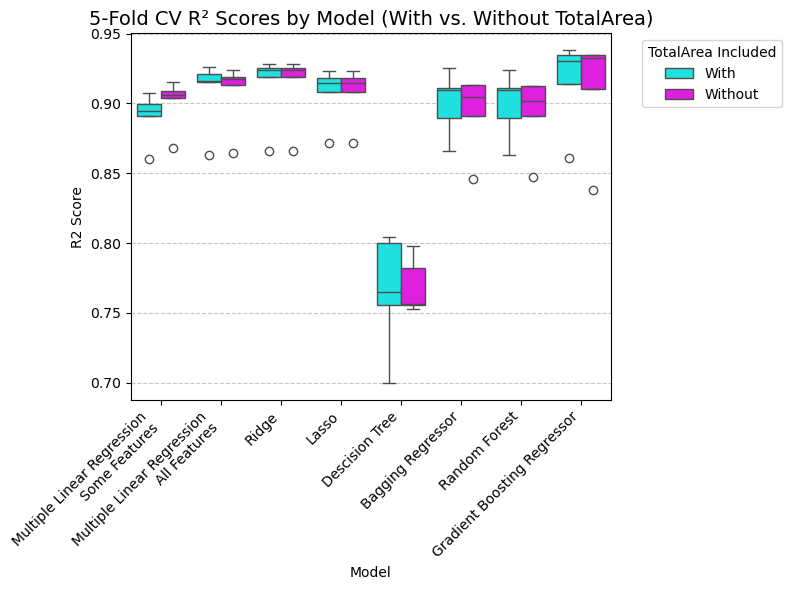


Standard Deviation of R² Scores for Each Model:
Model                                       TotalArea
Bagging Regressor                           With         0.0231
                                            Without      0.0281
Descision Tree                              With         0.0421
                                            Without      0.0201
Gradient Boosting Regressor                 With         0.0320
                                            Without      0.0418
Lasso                                       With         0.0208
                                            Without      0.0208
Multiple Linear Regression\n All Features   With         0.0256
                                            Without      0.0243
Multiple Linear Regression\n Some Features  With         0.0179
                                            Without      0.0187
Random Forest                               With         0.0239
                                            Without      0.0272
R

In [23]:
custom_palette = {'With': 'cyan', 'Without': 'magenta'}

# Plot
plt.figure(figsize=(8, 6))
sns.boxplot(x='Model', y='R2 Score', hue='TotalArea', data=cv_values, palette=custom_palette)
plt.title('5-Fold CV R² Scores by Model (With vs. Without TotalArea)', fontsize=14)
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(title='TotalArea Included', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

# Calculate standard deviation for each model grouped by 'Model' and 'TotalArea'
std_dev_summary = cv_values.groupby(['Model', 'TotalArea'])['R2 Score'].std().round(4)

print("\nStandard Deviation of R² Scores for Each Model:")
print(std_dev_summary)

In [24]:
from sklearn.feature_selection import SequentialFeatureSelector

In [25]:
numeric_data = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice'])

# Define X and y properly
X = numeric_data
y = price['SalePrice']

# Initialize the model
model_ML = LinearRegression()

# Prepare to collect feature scores
feature_scores_ml = {}

# Evaluate each feature separately using cross-validation
for feature in X.columns:
    X_single = X[[feature]]  # must be 2D
    cv_scores = cross_val_score(model_ML, X_single, y, cv=5)  # 5-fold CV
    feature_scores_ml[feature] = cv_scores.mean()

# Sort features by mean CV R² score (descending)
sorted_features_ml = sorted(feature_scores_ml.items(), key=lambda item: item[1], reverse=True)

# Get top 5
top_5_ml = sorted_features_ml[:5]

# Display top 5 features and their scores
print("Top 5 Features based on Mean CV R²:")
for feature, score in top_5_ml:
    print(f"Feature: {feature}, Mean CV R²: {score:.4f}")

Top 5 Features based on Mean CV R²:
Feature: TotalArea, Mean CV R²: 0.7279
Feature: OverallQual, Mean CV R²: 0.6180
Feature: GrLivArea, Mean CV R²: 0.5128
Feature: TotalBsmtSF, Mean CV R²: 0.4063
Feature: TotalBathrooms, Mean CV R²: 0.4044


In [26]:
# Initialize the model
model_R = Ridge()

# Prepare to collect feature scores
feature_scores_r = {}

# Evaluate each feature separately using cross-validation
for feature in X.columns:
    X_single = X[[feature]]  # must be 2D
    cv_scores = cross_val_score(model_R, X_single, y, cv=5)  # 5-fold CV
    feature_scores_r[feature] = cv_scores.mean()

# Sort features by mean CV R² score (descending)
sorted_features_r = sorted(feature_scores_r.items(), key=lambda item: item[1], reverse=True)

# Get top 5
top_5_r = sorted_features_r[:5]

# Display top 5 features and their scores
print("Top 5 Features based on Mean CV R²:")
for feature, score in top_5_r:
    print(f"Feature: {feature}, Mean CV R²: {score:.4f}")

Top 5 Features based on Mean CV R²:
Feature: TotalArea, Mean CV R²: 0.7279
Feature: OverallQual, Mean CV R²: 0.6180
Feature: GrLivArea, Mean CV R²: 0.5128
Feature: TotalBsmtSF, Mean CV R²: 0.4063
Feature: TotalBathrooms, Mean CV R²: 0.4044


In [27]:
# Initialize the model
model_L = Lasso()

# Prepare to collect feature scores
feature_scores_l = {}

# Evaluate each feature separately using cross-validation
for feature in X.columns:
    X_single = X[[feature]]  # must be 2D
    cv_scores = cross_val_score(model_L, X_single, y, cv=5)  # 5-fold CV
    feature_scores_l[feature] = cv_scores.mean()

# Sort features by mean CV R² score (descending)
sorted_features_l = sorted(feature_scores_l.items(), key=lambda item: item[1], reverse=True)

# Get top 5
top_5_l = sorted_features_l[:5]

# Display top 5 features and their scores
print("Top 5 Features based on Mean CV R²:")
for feature, score in top_5_l:
    print(f"Feature: {feature}, Mean CV R²: {score:.4f}")

Top 5 Features based on Mean CV R²:
Feature: TotalArea, Mean CV R²: 0.7279
Feature: OverallQual, Mean CV R²: 0.6180
Feature: GrLivArea, Mean CV R²: 0.5128
Feature: TotalBsmtSF, Mean CV R²: 0.4063
Feature: TotalBathrooms, Mean CV R²: 0.4044


In [28]:
# Initialize the model
model_T = DecisionTreeRegressor()

# Prepare to collect feature scores
feature_scores_t = {}

# Evaluate each feature separately using cross-validation
for feature in X.columns:
    X_single = X[[feature]]  # must be 2D
    cv_scores = cross_val_score(model_T, X_single, y, cv=5)  # 5-fold CV
    feature_scores_t[feature] = cv_scores.mean()

# Sort features by mean CV R² score (descending)
sorted_features_t = sorted(feature_scores_t.items(), key=lambda item: item[1], reverse=True)

# Get top 5
top_5_t = sorted_features_t[:5]

# Display top 5 features and their scores
print("Top 5 Features based on Mean CV R²:")
for feature, score in top_5_t:
    print(f"Feature: {feature}, Mean CV R²: {score:.4f}")

Top 5 Features based on Mean CV R²:
Feature: OverallQual, Mean CV R²: 0.6788
Feature: TotalArea, Mean CV R²: 0.4932
Feature: GarageCars, Mean CV R²: 0.4747
Feature: TotalBathrooms, Mean CV R²: 0.4288
Feature: YearBuilt, Mean CV R²: 0.3643


In [29]:
# Initialize the model
model_F = RandomForestRegressor()

# Prepare to collect feature scores
feature_scores_f = {}

# Evaluate each feature separately using cross-validation
for feature in X.columns:
    X_single = X[[feature]]  # must be 2D
    cv_scores = cross_val_score(model_F, X_single, y, cv=5)  # 5-fold CV
    feature_scores_f[feature] = cv_scores.mean()

# Sort features by mean CV R² score (descending)
sorted_features_f = sorted(feature_scores_f.items(), key=lambda item: item[1], reverse=True)

# Get top 5
top_5_f = sorted_features_f[:5]

# Display top 5 features and their scores
print("Top 5 Features based on Mean CV R²:")
for feature, score in top_5_f:
    print(f"Feature: {feature}, Mean CV R²: {score:.4f}")

Top 5 Features based on Mean CV R²:
Feature: OverallQual, Mean CV R²: 0.6786
Feature: TotalArea, Mean CV R²: 0.6246
Feature: GarageCars, Mean CV R²: 0.4748
Feature: TotalBathrooms, Mean CV R²: 0.4282
Feature: GarageArea, Mean CV R²: 0.4007


In [30]:
# Initialize the model
model_B = BaggingRegressor()

# Prepare to collect feature scores
feature_scores_b = {}

# Evaluate each feature separately using cross-validation
for feature in X.columns:
    X_single = X[[feature]]  # must be 2D
    cv_scores = cross_val_score(model_B, X_single, y, cv=5)  # 5-fold CV
    feature_scores_b[feature] = cv_scores.mean()

# Sort features by mean CV R² score (descending)
sorted_features_b = sorted(feature_scores_b.items(), key=lambda item: item[1], reverse=True)

# Get top 5
top_5_b = sorted_features_b[:5]

# Display top 5 features and their scores
print("Top 5 Features based on Mean CV R²:")
for feature, score in top_5_b:
    print(f"Feature: {feature}, Mean CV R²: {score:.4f}")

Top 5 Features based on Mean CV R²:
Feature: OverallQual, Mean CV R²: 0.6802
Feature: TotalArea, Mean CV R²: 0.6089
Feature: GarageCars, Mean CV R²: 0.4739
Feature: TotalBathrooms, Mean CV R²: 0.4257
Feature: GarageArea, Mean CV R²: 0.3933


In [31]:
# Initialize the model
model_G = GradientBoostingRegressor()

# Prepare to collect feature scores
feature_scores_g = {}

# Evaluate each feature separately using cross-validation
for feature in X.columns:
    X_single = X[[feature]]  # must be 2D
    cv_scores = cross_val_score(model_G, X_single, y, cv=5)  # 5-fold CV
    feature_scores_g[feature] = cv_scores.mean()

# Sort features by mean CV R² score (descending)
sorted_features_g = sorted(feature_scores_g.items(), key=lambda item: item[1], reverse=True)

# Get top 5
top_5_g = sorted_features_g[:5]

# Display top 5 features and their scores
print("Top 5 Features based on Mean CV R²:")
for feature, score in top_5_g:
    print(f"Feature: {feature}, Mean CV R²: {score:.4f}")

Top 5 Features based on Mean CV R²:
Feature: TotalArea, Mean CV R²: 0.7084
Feature: OverallQual, Mean CV R²: 0.6788
Feature: GarageCars, Mean CV R²: 0.4747
Feature: GrLivArea, Mean CV R²: 0.4572
Feature: GarageArea, Mean CV R²: 0.4422


In [32]:
# Extracting the top 5 features
top_features_ml = [feature for feature, score in top_5_ml]
top_features_r = [feature for feature, score in top_5_r]
top_features_l = [feature for feature, score in top_5_l]
top_features_t = [feature for feature, score in top_5_t]
top_features_f = [feature for feature, score in top_5_f]
top_features_b = [feature for feature, score in top_5_b]
top_features_g = [feature for feature, score in top_5_g]
 
# Building the model with the top 5 features
X_top_ml = price[top_features_ml]
X_top_r = price[top_features_r]
X_top_l = price[top_features_l]
X_top_t = price[top_features_t]
X_top_f = price[top_features_f]
X_top_b = price[top_features_b]
X_top_g = price[top_features_g]
 
# Evaluating the model with cross-validation
cv_scores_mlr = cross_val_score(model_ML, X_top_ml, y, cv=5, scoring="r2")
mean_mlr_score = cv_scores_mlr.mean()

# Evaluating the model with cross-validation
cv_scores_r = cross_val_score(model_R, X_top_r, y, cv=5, scoring="r2")
mean_r_score = cv_scores_r.mean()

# Evaluating the model with cross-validation
cv_scores_l = cross_val_score(model_L, X_top_l, y, cv=5, scoring="r2")
mean_l_score = cv_scores_l.mean()

# Evaluating the model with cross-validation
cv_scores_t = cross_val_score(model_T, X_top_t, y, cv=5, scoring="r2")
mean_t_score = cv_scores_t.mean()

# Evaluating the model with cross-validation
cv_scores_f = cross_val_score(model_F, X_top_f, y, cv=5, scoring="r2")
mean_f_score = cv_scores_f.mean()

# Evaluating the model with cross-validation
cv_scores_b = cross_val_score(model_B, X_top_b, y, cv=5, scoring="r2")
mean_b_score = cv_scores_b.mean()

# Evaluating the model with cross-validation
cv_scores_g = cross_val_score(model_G, X_top_g, y, cv=5, scoring="r2")
mean_g_score = cv_scores_g.mean()
 
print(f"Mean CV R² Score for Multiple Linear Regression Model: {mean_mlr_score:.4f}")
print(f"Mean CV R² Score for Ridge Regression Model: {mean_r_score:.4f}")
print(f"Mean CV R² Score for Lasso Regression Model: {mean_l_score:.4f}")
print(f"Mean CV R² Score for Decision Tree Regressor Model: {mean_t_score:.4f}")
print(f"Mean CV R² Score for Random Forest Regressor Model: {mean_f_score:.4f}")
print(f"Mean CV R² Score for Bagging Regressor Model: {mean_b_score:.4f}")
print(f"Mean CV R² Score for Gradient Boosting Regressor Model: {mean_g_score:.4f}")

Mean CV R² Score for Multiple Linear Regression Model: 0.8166
Mean CV R² Score for Ridge Regression Model: 0.8166
Mean CV R² Score for Lasso Regression Model: 0.8166
Mean CV R² Score for Decision Tree Regressor Model: 0.7440
Mean CV R² Score for Random Forest Regressor Model: 0.8368
Mean CV R² Score for Bagging Regressor Model: 0.8275
Mean CV R² Score for Gradient Boosting Regressor Model: 0.8405


In [33]:
# Apply Sequential Feature Selector with tolerance = 0.005, building on code above
sfs_tol_ml = SequentialFeatureSelector(model_ML, n_features_to_select="auto", tol=0.005)
sfs_tol_ml.fit(X, y)

sfs_tol_r = SequentialFeatureSelector(model_R, n_features_to_select="auto", tol=0.005)
sfs_tol_r.fit(X, y)

sfs_tol_l = SequentialFeatureSelector(model_L, n_features_to_select="auto", tol=0.005)
sfs_tol_l.fit(X, y)

sfs_tol_t = SequentialFeatureSelector(model_T, n_features_to_select="auto", tol=0.005)
sfs_tol_t.fit(X, y)

sfs_tol_f = SequentialFeatureSelector(model_F, n_features_to_select="auto", tol=0.005)
sfs_tol_f.fit(X, y)

sfs_tol_b = SequentialFeatureSelector(model_B, n_features_to_select="auto", tol=0.005)
sfs_tol_b.fit(X, y)

sfs_tol_g = SequentialFeatureSelector(model_G, n_features_to_select="auto", tol=0.005)
sfs_tol_g.fit(X, y)
 
# Get the number of features selected with tolerance
n_features_selected_ml = sum(sfs_tol_ml.get_support())
n_features_selected_r = sum(sfs_tol_r.get_support())
n_features_selected_l = sum(sfs_tol_l.get_support())
n_features_selected_t = sum(sfs_tol_t.get_support())
n_features_selected_f = sum(sfs_tol_f.get_support())
n_features_selected_b = sum(sfs_tol_b.get_support())
n_features_selected_g = sum(sfs_tol_g.get_support())

In [34]:
# Prepare to store the mean CV R² scores for each number of features
mean_scores_tol_ml = []
 
# Iterate over a range from 1 feature to the Sweet Spot
for n_features_to_select in range(1, n_features_selected_ml + 1):
    sfs = SequentialFeatureSelector(model_ML, n_features_to_select=n_features_to_select)
    sfs.fit(X, y)
    selected_features = X.columns[sfs.get_support()]
    score = cross_val_score(model_ML, X[selected_features], y, cv=5, scoring="r2").mean()
    mean_scores_tol_ml.append(score)

    # Prepare to store the mean CV R² scores for each number of features
mean_scores_tol_r = []
 
# Iterate over a range from 1 feature to the Sweet Spot
for n_features_to_select in range(1, n_features_selected_r + 1):
    sfs = SequentialFeatureSelector(model_R, n_features_to_select=n_features_to_select)
    sfs.fit(X, y)
    selected_features = X.columns[sfs.get_support()]
    score = cross_val_score(model_R, X[selected_features], y, cv=5, scoring="r2").mean()
    mean_scores_tol_r.append(score)
   

# Prepare to store the mean CV R² scores for each number of features
mean_scores_tol_l = []

# Iterate over a range from 1 feature to the Sweet Spot
for n_features_to_select in range(1, n_features_selected_l + 1):
    sfs = SequentialFeatureSelector(model_L, n_features_to_select=n_features_to_select)
    sfs.fit(X, y)
    selected_features = X.columns[sfs.get_support()]
    score = cross_val_score(model_L, X[selected_features], y, cv=5, scoring="r2").mean()
    mean_scores_tol_l.append(score)

    # Prepare to store the mean CV R² scores for each number of features
mean_scores_tol_t = []
 
# Iterate over a range from 1 feature to the Sweet Spot
for n_features_to_select in range(1, n_features_selected_t + 1):
    sfs = SequentialFeatureSelector(model_T, n_features_to_select=n_features_to_select)
    sfs.fit(X, y)
    selected_features = X.columns[sfs.get_support()]
    score = cross_val_score(model_T, X[selected_features], y, cv=5, scoring="r2").mean()
    mean_scores_tol_t.append(score)

    # Prepare to store the mean CV R² scores for each number of features
mean_scores_tol_f = []

# Iterate over a range from 1 feature to the Sweet Spot
for n_features_to_select in range(1, n_features_selected_f + 1):
    sfs = SequentialFeatureSelector(model_F, n_features_to_select=n_features_to_select)
    sfs.fit(X, y)
    selected_features = X.columns[sfs.get_support()]
    score = cross_val_score(model_F, X[selected_features], y, cv=5, scoring="r2").mean()
    mean_scores_tol_f.append(score)

    # Prepare to store the mean CV R² scores for each number of features
mean_scores_tol_b = []

# Iterate over a range from 1 feature to the Sweet Spot
for n_features_to_select in range(1, n_features_selected_b + 1):
    sfs = SequentialFeatureSelector(model_B, n_features_to_select=n_features_to_select)
    sfs.fit(X, y)
    selected_features = X.columns[sfs.get_support()]
    score = cross_val_score(model_B, X[selected_features], y, cv=5, scoring="r2").mean()
    mean_scores_tol_b.append(score)

    # Prepare to store the mean CV R² scores for each number of features
mean_scores_tol_g = []

# Iterate over a range from 1 feature to the Sweet Spot
for n_features_to_select in range(1, n_features_selected_g + 1):
    sfs = SequentialFeatureSelector(model_G, n_features_to_select=n_features_to_select)
    sfs.fit(X, y)
    selected_features = X.columns[sfs.get_support()]
    score = cross_val_score(model_G, X[selected_features], y, cv=5, scoring="r2").mean()
    mean_scores_tol_g.append(score)

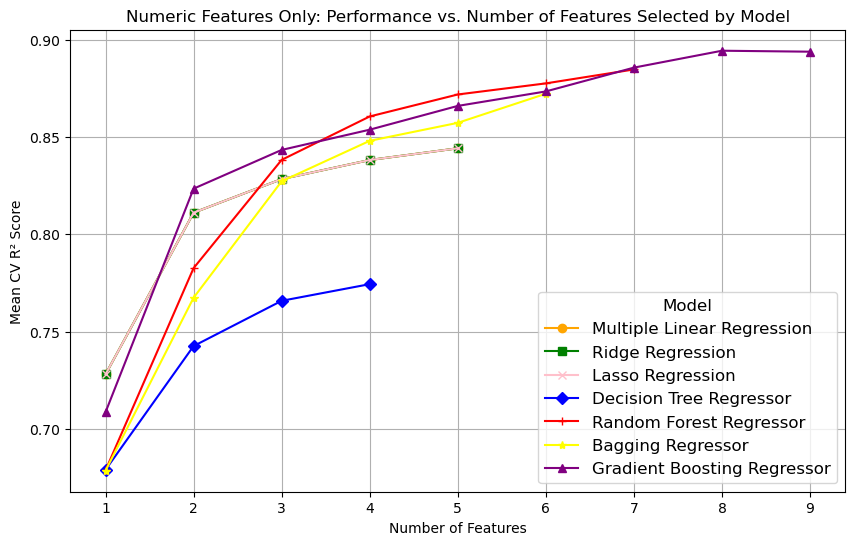

In [35]:
# Plot the mean CV R² scores against the number of features selected
plt.figure(figsize=(10, 6))
plt.plot(range(1, n_features_selected_ml + 1), mean_scores_tol_ml, label='Multiple Linear Regression', marker='o', color='orange')
plt.plot(range(1, n_features_selected_r + 1), mean_scores_tol_r, label='Ridge Regression', marker='s', color='green')
plt.plot(range(1, n_features_selected_l + 1), mean_scores_tol_l, label='Lasso Regression', marker='x', color='pink')
plt.plot(range(1, n_features_selected_t + 1), mean_scores_tol_t, label='Decision Tree Regressor', marker='D', color='blue')
plt.plot(range(1, n_features_selected_f + 1), mean_scores_tol_f, label='Random Forest Regressor', marker='+', color='red')
plt.plot(range(1, n_features_selected_b + 1), mean_scores_tol_b, label='Bagging Regressor', marker='*', color='yellow')
plt.plot(range(1, n_features_selected_g + 1), mean_scores_tol_g, label='Gradient Boosting Regressor', marker='^', color='purple')

# plt.plot(range(1, n_features_selected + 1), mean_scores_tol, marker="o")
plt.title("Numeric Features Only: Performance vs. Number of Features Selected by Model")
plt.xlabel("Number of Features")
plt.ylabel("Mean CV R² Score")
plt.grid(True)
plt.legend(title='Model', fontsize=12, title_fontsize=12, loc='best')
plt.show()

In [36]:
# Multiple Linear Regression
selected_features_ml = X.columns[sfs_tol_ml.get_support()]
print(f"Number of features selected for Multiple Linear Regression: {n_features_selected_ml}")
print(f"Selected features: {selected_features_ml.tolist()}")
print(f"Mean CV R² Score using SFS with tol=0.005: {mean_scores_tol_ml[-1]:.4f}")

# Ridge Regression
selected_features_r = X.columns[sfs_tol_r.get_support()]
print(f"Number of features selected for Ridge: {n_features_selected_r}")
print(f"Selected features: {selected_features_r.tolist()}")
print(f"Mean CV R² Score using SFS with tol=0.005: {mean_scores_tol_r[-1]:.4f}")

# Lasso Regression
selected_features_l = X.columns[sfs_tol_l.get_support()]
print(f"Number of features selected for Lasso: {n_features_selected_l}")
print(f"Selected features: {selected_features_l.tolist()}")
print(f"Mean CV R² Score using SFS with tol=0.005: {mean_scores_tol_l[-1]:.4f}")

# Decision Tree
selected_features_t = X.columns[sfs_tol_t.get_support()]
print(f"Number of features selected for Decision Tree: {n_features_selected_t}")
print(f"Selected features: {selected_features_t.tolist()}")
print(f"Mean CV R² Score using SFS with tol=0.005: {mean_scores_tol_t[-1]:.4f}")

# Random Forest
selected_features_f = X.columns[sfs_tol_f.get_support()]
print(f"Number of features selected for Random Forest: {n_features_selected_f}")
print(f"Selected features: {selected_features_f.tolist()}")
print(f"Mean CV R² Score using SFS with tol=0.005: {mean_scores_tol_f[-1]:.4f}")

# Bagging Regressor
selected_features_b = X.columns[sfs_tol_b.get_support()]
print(f"Number of features selected for Bagging Regressor: {n_features_selected_b}")
print(f"Selected features: {selected_features_b.tolist()}")
print(f"Mean CV R² Score using SFS with tol=0.005: {mean_scores_tol_b[-1]:.4f}")

# Gradient Boosting
selected_features_g = X.columns[sfs_tol_g.get_support()]
print(f"Number of features selected for Gradient Boosting Regressor: {n_features_selected_g}")
print(f"Selected features: {selected_features_g.tolist()}")
print(f"Mean CV R² Score using SFS with tol=0.005: {mean_scores_tol_g[-1]:.4f}")


Number of features selected for Multiple Linear Regression: 5
Selected features: ['MSSubClass', 'OverallQual', 'YearRemodAdd', 'BsmtUnfSF', 'TotalArea']
Mean CV R² Score using SFS with tol=0.005: 0.8443
Number of features selected for Ridge: 5
Selected features: ['MSSubClass', 'OverallQual', 'YearRemodAdd', 'BsmtUnfSF', 'TotalArea']
Mean CV R² Score using SFS with tol=0.005: 0.8443
Number of features selected for Lasso: 5
Selected features: ['MSSubClass', 'OverallQual', 'YearRemodAdd', 'BsmtUnfSF', 'TotalArea']
Mean CV R² Score using SFS with tol=0.005: 0.8443
Number of features selected for Decision Tree: 4
Selected features: ['OverallQual', 'Fireplaces', 'GarageCars', 'TotalBathrooms']
Mean CV R² Score using SFS with tol=0.005: 0.7744
Number of features selected for Random Forest: 7
Selected features: ['LotArea', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'BsmtUnfSF', 'TotalArea']
Mean CV R² Score using SFS with tol=0.005: 0.8848
Number of features selected for Baggin

In [59]:
X = price.drop(columns=['PID', 'SalePrice'])
y = price['SalePrice']

# Manually specify the categories for ordinal encoding according to the data dictionary
ordinal_order = {
    'Electrical': ['Mix', 'FuseP', 'FuseF', 'FuseA', 'SBrkr'],  # Electrical system
    'LotShape': ['IR3', 'IR2', 'IR1', 'Reg'],  # General shape of property
    'Utilities': ['ELO', 'NoSeWa', 'NoSewr', 'AllPub'],  # Type of utilities available
    'LandSlope': ['Sev', 'Mod', 'Gtl'],  # Slope of property
    'ExterQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Evaluates the quality of the material on the exterior
    'ExterCond': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Evaluates the present condition of the material on the exterior
    'BsmtQual': ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Height of the basement
    'BsmtCond': ['No Basement', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # General condition of the basement
    'BsmtExposure': ['No Basement', 'No', 'Mn', 'Av', 'Gd'],  # Walkout or garden level basement walls
    'BsmtFinType1': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],  # Quality of basement finished area
    'BsmtFinType2': ['No Basement', 'Unf', 'LwQ', 'Rec', 'BLQ', 'ALQ', 'GLQ'],  # Quality of second basement finished area
    'HeatingQC': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Heating quality and condition
    'KitchenQual': ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Kitchen quality
    'Functional': ['Sal', 'Sev', 'Maj2', 'Maj1', 'Mod', 'Min2', 'Min1', 'Typ'],  # Home functionality
    'FireplaceQu': ['No Fireplace', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Fireplace quality
    'GarageFinish': ['No Garage', 'Unf', 'RFn', 'Fin'],  # Interior finish of the garage
    'GarageQual': ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Garage quality
    'GarageCond': ['No Garage', 'Po', 'Fa', 'TA', 'Gd', 'Ex'],  # Garage condition
    'PavedDrive': ['N', 'P', 'Y'],  # Paved driveway
    'PoolQC': ['No Pool', 'Fa', 'TA', 'Gd', 'Ex'],  # Pool quality
    'Fence': ['No Fence', 'MnWw', 'GdWo', 'MnPrv', 'GdPrv']  # Fence quality
}

# Adjust data types for categorical variables
for col in ['MSSubClass', 'YrSold', 'MoSold']:
    price[col] = price[col].astype('object')
 
# Numeric and categorical columns
numeric_features = X.select_dtypes(include=['int64', 'float64']).columns.tolist()
categorical_features = X.select_dtypes(include=['object']).columns.difference(['Electrical']).tolist()
electrical_feature = ['Electrical']

# Extract list of ALL ordinal features from dictionary
ordinal_features = list(ordinal_order.keys())
 
# List of ordinal features except Electrical
ordinal_except_electrical = [feature for feature in ordinal_features if feature != 'Electrical']

# Define transformations for various feature types
electrical_transformer = Pipeline(steps=[
    ('impute_electrical', SimpleImputer(strategy='most_frequent')),
    ('ordinal_electrical', OrdinalEncoder(categories=[ordinal_order['Electrical']]))
])
 
numeric_transformer = Pipeline(steps=[
    ('impute_mean', SimpleImputer(strategy='mean'))
])
 
# Updated categorical imputer using SimpleImputer
categorical_imputer = SimpleImputer(strategy='constant', fill_value='None')
 
ordinal_transformer = Pipeline([
    ('impute_ordinal', categorical_imputer),
    ('ordinal', OrdinalEncoder(categories=[ordinal_order[feature] for feature in ordinal_features if feature in ordinal_except_electrical]))
])
 
nominal_features = [feature for feature in categorical_features if feature not in ordinal_features]
categorical_transformer = Pipeline([
    ('impute_nominal', categorical_imputer),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for numeric, ordinal, nominal, and specific electrical data
preprocessor = ColumnTransformer(
    transformers=[
        ('electrical', electrical_transformer, ['Electrical']),
        ('num', numeric_transformer, numeric_features),
        ('ordinal', ordinal_transformer, ordinal_except_electrical),
        ('nominal', categorical_transformer, nominal_features)
])

model_G_all = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', GradientBoostingRegressor(random_state=42))
])

model_G_all.fit(X, y)

# Get feature importances
importances = model_G_all.named_steps['regressor'].feature_importances_

# Get feature names
feature_names_num = numeric_features
feature_names_ord = ordinal_except_electrical
feature_names_elec = ['Electrical']  # Only one
feature_names_nom = model_G_all.named_steps['preprocessor'].named_transformers_['nominal'].named_steps['onehot'].get_feature_names_out(nominal_features)

all_feature_names = feature_names_num + feature_names_ord + feature_names_elec + feature_names_nom.tolist()

# Show sorted importances
import pandas as pd
importance_df = pd.DataFrame({'Feature': all_feature_names, 'Importance': importances})
importance_df = importance_df.sort_values(by='Importance', ascending=False)

print(importance_df)  # Top 20 important features

                   Feature  Importance
33           TotalFullBath    0.534252
4              OverallCond    0.232311
6             YearRemodAdd    0.031758
37                LotShape    0.022908
43                BsmtCond    0.021654
49              Functional    0.020011
1              LotFrontage    0.014702
9               BsmtFinSF2    0.012442
7               MasVnrArea    0.011049
34           TotalHalfBath    0.010054
3              OverallQual    0.009702
51            GarageFinish    0.008761
14            LowQualFinSF    0.007902
5                YearBuilt    0.007214
41               ExterCond    0.005292
23              GarageCars    0.005019
303   Neighborhood_Crawfor    0.003628
12                1stFlrSF    0.003383
45            BsmtFinType1    0.003189
27           EnclosedPorch    0.003082
66            CentralAir_N    0.003063
274            MSZoning_RL    0.002817
322   Neighborhood_StoneBr    0.001922
88     Exterior1st_BrkFace    0.001464
8               BsmtFinSF

In [61]:
# Separate features
numeric_features_mae = X.select_dtypes(include=['int64', 'float64']).columns.tolist()
categorical_features_mae = X.select_dtypes(include=['object']).columns.tolist()

# Numeric preprocessing
numeric_transformer_mae = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='mean')),
    ('scaler', StandardScaler())
])

# Categorical preprocessing
categorical_transformer_mae = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Full preprocessor
preprocessor_mae = ColumnTransformer(transformers=[
    ('num', numeric_transformer_mae, numeric_features_mae),
    ('cat', categorical_transformer_mae, categorical_features_mae)
])

# Define models wrapped in Pipelines with preprocessing
models_mae = {
    'Multiple Linear Regression': Pipeline(steps=[('preprocessor', preprocessor_mae),
                                                  ('regressor', LinearRegression())]),
    'Ridge': Pipeline(steps=[('preprocessor', preprocessor_mae),
                             ('regressor', Ridge())]),
    'Lasso': Pipeline(steps=[('preprocessor', preprocessor_mae),
                             ('regressor', Lasso())]),
    'Decision Tree': Pipeline(steps=[('preprocessor', preprocessor_mae),
                                     ('regressor', DecisionTreeRegressor())]),
    'Random Forest': Pipeline(steps=[('preprocessor', preprocessor_mae),
                                     ('regressor', RandomForestRegressor())]),
    'Bagging': Pipeline(steps=[('preprocessor', preprocessor_mae),
                               ('regressor', BaggingRegressor())]),
    'Gradient Boosting': Pipeline(steps=[('preprocessor', preprocessor_mae),
                                         ('regressor', GradientBoostingRegressor())])
}

# Compute MAE using cross-validation
mae_scores = {}

for name, model in models_mae.items():
    scores = cross_val_score(model, X, y, cv=5, scoring='neg_mean_absolute_error')
    mae_scores[name] = -scores.mean()  # negate because sklearn returns negative MAE

# Print results
for name, score in mae_scores.items():
    print(f"{name}: Mean MAE = {score:.4f}")

/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37054615174.718445, tolerance: 1090499258.1211665
  model = cd_fast.sparse_enet_coordinate_descent(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 89659206258.42749, tolerance: 1095980866.342594
  model = cd_fast.sparse_enet_coordinate_descent(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 82780325392.53625, tolerance: 1189901463.3215556
  model = cd_fast.sparse_enet_coordinate_descent(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_desce

Multiple Linear Regression: Mean MAE = 15045.4510
Ridge: Mean MAE = 14509.6463
Lasso: Mean MAE = 14856.9684
Decision Tree: Mean MAE = 22467.8116
Random Forest: Mean MAE = 14814.5072
Bagging: Mean MAE = 15742.2892
Gradient Boosting: Mean MAE = 13856.3299


In [62]:
from sklearn.metrics import mean_absolute_error

# Define features and target
features_9 = ['MSSubClass', 'YearRemodAdd', 'BsmtUnfSF', 'OverallQual', 'TotalArea', 
              'Neighborhood', 'BsmtQual', 'OverallCond', 'KitchenQual']
target_9 = 'SalePrice' 


# Separate predictors and response
X_9 = price[features_9]
y_9 = price[target_9]


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor_9 = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), ['Neighborhood', 'BsmtQual', 'KitchenQual', 'MSSubClass'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Create pipeline: preprocessing + linear regression
pipeline_9 = Pipeline([
    ('prep', preprocessor_9),
    ('reg', LinearRegression())
])

# Fit model
pipeline_9.fit(X_9, y_9)

# Predict and evaluate
y_pred_9 = pipeline_9.predict(X_9)
r2_9 = r2_score(y_9, y_pred_9)
rss_9 = np.sum((y_9 - y_pred_9) ** 2)

# Cross-validation scores
cv_scores_9 = cross_val_score(pipeline_9, X_9, y_9, scoring='r2', cv=5)

# Calculate MAE
mae_9 = mean_absolute_error(y_9, y_pred_9)

# Output
print('9 Features')
print(f"R²: {r2_9:.4f}")
print(f"RSS: {rss_9:,.2f}")
print(f"MAE: {mae_9:.2f}")
print(cv_scores_9)
print(cv_scores_9.mean())

9 Features
R²: 0.8970
RSS: 1,495,145,379,934.39
MAE: 15862.52
[0.85930422 0.891506   0.90426704 0.89727394 0.90124467]
0.8907191752176347


/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [2] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/preprocessing/_encoders.py:242: UserWarning: Found unknown categories in columns [3] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [109]:
# Select the specific row you want (for example, row index 184)
sample_row = X.iloc[[184]]  # double brackets keep it as a DataFrame

print("Predicted SalePrice for row 184 across all models:\n")
for name, model in models_mae.items():
    # Leave out row 184 for testing
    X_train = X.drop(index=184)
    y_train = y.drop(index=184)
    X_test = X.iloc[[184]]
    
    model.fit(X_train, y_train)
    predicted_price = model.predict(X_test)
    print(f"{name}: ${predicted_price[0]:,.2f}")

Predicted SalePrice for row 184 across all models:

Multiple Linear Regression: $245,735.86
Ridge: $245,307.14


/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 53974342116.05823, tolerance: 1451377008.3267968
  model = cd_fast.sparse_enet_coordinate_descent(


Lasso: $245,514.80
Decision Tree: $224,900.00
Random Forest: $246,795.55
Bagging: $243,750.00
Gradient Boosting: $247,040.21


In [105]:
# Train model on only your selected features:
selected_features_9 = ['TotalArea', 'OverallQual', 'YearRemodAdd', 
                       'BsmtQual', 'MSSubClass', 'Neighborhood', 
                       'KitchenQual', 'BsmtUnfSF', 'OverallCond']

X_subset = X[selected_features_9]

# Select correct preprocessors:
numeric_features_subset = [f for f in selected_features_9 if f in numeric_features_mae]
categorical_features_subset = [f for f in selected_features_9 if f in categorical_features_mae]

preprocessor_subset = ColumnTransformer(transformers=[
    ('num', numeric_transformer_mae, numeric_features_subset),
    ('cat', categorical_transformer_mae, categorical_features_subset)
])

model_subset = Pipeline(steps=[('preprocessor', preprocessor_subset),
                               ('regressor', LinearRegression())])

model_subset.fit(X_subset, y)

# Predict for row 184 on the 9 selected features
sample_row_subset = X_subset.iloc[[184]]
predicted_price_subset = model_subset.predict(sample_row_subset)

print(f"Predicted SalePrice using ONLY 9 features for Row 184: ${predicted_price_subset[0]:,.2f}")

Predicted SalePrice using ONLY 9 features for Row 184: $243,254.68


In [107]:
from collections import Counter

# All selected features from your models
all_selected_features = [
    ['MSSubClass', 'OverallQual', 'YearRemodAdd', 'BsmtUnfSF', 'TotalArea'],                         # Multiple Linear Regression
    ['MSSubClass', 'OverallQual', 'YearRemodAdd', 'BsmtUnfSF', 'TotalArea'],                         # Ridge
    ['MSSubClass', 'OverallQual', 'YearRemodAdd', 'BsmtUnfSF', 'TotalArea'],                         # Lasso
    ['OverallQual', 'Fireplaces', 'GarageCars', 'TotalBathrooms'],                                   # Decision Tree
    ['LotArea', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'BsmtUnfSF', 'TotalArea'], # Random Forest
    ['MSSubClass', 'LotArea', 'OverallQual', 'YearRemodAdd', 'BsmtUnfSF', 'TotalArea'],              # Bagging
    ['LotFrontage', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', '2ndFlrSF', 
     'Fireplaces', 'TotalArea', 'TotalBathrooms']                                                   # Gradient Boosting
]

# Flatten the list into a single list of features
flat_list = [feature for sublist in all_selected_features for feature in sublist]

# Count how many times each feature was selected
feature_counts = Counter(flat_list)

# Display sorted by most frequent
print("Feature Selection Frequency across Models:\n")
for feature, count in feature_counts.most_common():
    print(f"{feature}: {count} times")


Feature Selection Frequency across Models:

OverallQual: 7 times
YearRemodAdd: 6 times
TotalArea: 6 times
BsmtUnfSF: 5 times
MSSubClass: 4 times
Fireplaces: 2 times
TotalBathrooms: 2 times
LotArea: 2 times
OverallCond: 2 times
YearBuilt: 2 times
GarageCars: 1 times
LotFrontage: 1 times
2ndFlrSF: 1 times
